<a href="https://colab.research.google.com/github/VedantDere0104/GANs/blob/main/CycleGAN_Pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
####

In [3]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import VOCSegmentation
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
import glob
import random
import os
from PIL import Image
from skimage import color
import numpy as np
plt.rcParams["figure.figsize"] = (10, 10)



In [4]:
def show_tensor_images(image_tensor , num_images = 25 , size = (1 , 28 , 28)):
  image_tensor = (image_tensor + 1)/2
  image_shifted = image_tensor
  image_unflat = image_shifted.detach().cpu().view(-1 , *size)
  image_grid = make_grid(image_unflat[:num_images] , nrow=5)
  plt.imshow(image_grid.permute(1 , 2 , 0).squeeze())
  plt.show()

In [5]:
class ImageDataset(Dataset):
  def __init__(self, root, transform=None, mode='train'):
    self.transform = transform
    self.files_A = sorted(glob.glob(os.path.join(root, '%sA' % mode) + '/*.*'))
    self.files_B = sorted(glob.glob(os.path.join(root, '%sB' % mode) + '/*.*'))
    if len(self.files_A) > len(self.files_B):
        self.files_A, self.files_B = self.files_B, self.files_A
    self.new_perm()
    assert len(self.files_A) > 0, "Make sure you downloaded the horse2zebra images!"

  def new_perm(self):
    self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]

  def __getitem__(self, index):
    item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
    item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))
    if item_A.shape[0] != 3: 
        item_A = item_A.repeat(3, 1, 1)
    if item_B.shape[0] != 3: 
        item_B = item_B.repeat(3, 1, 1)
    if index == len(self) - 1:
        self.new_perm()
    # Old versions of PyTorch didn't support normalization for different-channeled images
    return (item_A - 0.5) * 2, (item_B - 0.5) * 2

  def __len__(self):
    return min(len(self.files_A), len(self.files_B))

In [6]:

class ResidualBlock(nn.Module):

  def __init__(self, input_channels):
    super(ResidualBlock, self).__init__()
    self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
    self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
    self.instancenorm = nn.InstanceNorm2d(input_channels)
    self.activation = nn.ReLU()

  def forward(self, x):

    original_x = x.clone()
    x = self.conv1(x)
    x = self.instancenorm(x)
    x = self.activation(x)
    x = self.conv2(x)
    x = self.instancenorm(x)
    return original_x + x

In [7]:
class ContractingBlock(nn.Module):
 
  def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
    super(ContractingBlock, self).__init__()
    self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
    self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
    if use_bn:
        self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
    self.use_bn = use_bn

  def forward(self, x):

    x = self.conv1(x)
    if self.use_bn:
        x = self.instancenorm(x)
    x = self.activation(x)
    return x


In [8]:
class ExpandingBlock(nn.Module):

  def __init__(self, input_channels, use_bn=True):
    super(ExpandingBlock, self).__init__()
    self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
    if use_bn:
        self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
    self.use_bn = use_bn
    self.activation = nn.ReLU()

  def forward(self, x):

    x = self.conv1(x)
    if self.use_bn:
        x = self.instancenorm(x)
    x = self.activation(x)
    return x


In [9]:
class FeatureMapBlock(nn.Module):

  def __init__(self, input_channels, output_channels):
    super(FeatureMapBlock, self).__init__()
    self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

  def forward(self, x):

    x = self.conv(x)
    return x

In [10]:

class Generator(nn.Module):

  def __init__(self, input_channels, output_channels, hidden_channels=64):
    super(Generator, self).__init__()
    self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
    self.contract1 = ContractingBlock(hidden_channels)
    self.contract2 = ContractingBlock(hidden_channels * 2)
    res_mult = 4
    self.res0 = ResidualBlock(hidden_channels * res_mult)
    self.res1 = ResidualBlock(hidden_channels * res_mult)
    self.res2 = ResidualBlock(hidden_channels * res_mult)
    self.res3 = ResidualBlock(hidden_channels * res_mult)
    self.res4 = ResidualBlock(hidden_channels * res_mult)
    self.res5 = ResidualBlock(hidden_channels * res_mult)
    self.res6 = ResidualBlock(hidden_channels * res_mult)
    self.res7 = ResidualBlock(hidden_channels * res_mult)
    self.res8 = ResidualBlock(hidden_channels * res_mult)
    self.expand2 = ExpandingBlock(hidden_channels * 4)
    self.expand3 = ExpandingBlock(hidden_channels * 2)
    self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
    self.tanh = torch.nn.Tanh()

  def forward(self, x):

    x0 = self.upfeature(x)
    x1 = self.contract1(x0)
    x2 = self.contract2(x1)
    x3 = self.res0(x2)
    x4 = self.res1(x3)
    x5 = self.res2(x4)
    x6 = self.res3(x5)
    x7 = self.res4(x6)
    x8 = self.res5(x7)
    x9 = self.res6(x8)
    x10 = self.res7(x9)
    x11 = self.res8(x10)
    x12 = self.expand2(x11)
    x13 = self.expand3(x12)
    xn = self.downfeature(x13)
    return self.tanh(xn)

In [11]:
class Discriminator(nn.Module):

  def __init__(self, input_channels, hidden_channels=64):
    super(Discriminator, self).__init__()
    self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
    self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
    self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
    self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
    self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

  def forward(self, x):
    x0 = self.upfeature(x)
    x1 = self.contract1(x0)
    x2 = self.contract2(x1)
    x3 = self.contract3(x2)
    xn = self.final(x3)
    return xn

In [12]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss()
recon_criterion = nn.L1Loss()
n_epochs = 20
dim_A = 3
dim_B = 3
display_step = 200
batch_size = 1
lr = 0.0002
load_shape = 286
target_shape = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [13]:

transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.RandomCrop(target_shape),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

import torchvision
dataset = ImageDataset("/content/drive/MyDrive/horse2zebra", transform=transform)

In [14]:
gen_AB = Generator(dim_A , dim_B).to(device)
gen_BA = Generator(dim_B , dim_A).to(device)
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()) , lr = lr , betas=(0.5 , 0.999) )
disc_A = Discriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters() , lr = lr , betas = (0.5 , 0.999))
disc_B = Discriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters()  , lr = lr , betas = (0.5 , 0.999))

In [15]:
def weights_init(m):
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

In [16]:
pretrained = False
if pretrained:
  pre_dict = torch.load('cycleGAN_100000.pth')
  gen_AB.load_state_dict(pre_dict['gen_AB'])
  gen_BA.load_state_dict(pre_dict['gen_BA'])
  gen_opt.load_state_dict(pre_dict['gen_opt'])
  disc_A.load_state_dict(pre_dict['disc_A'])
  disc_A_opt.load_state_dict(pre_dict['disc_A_opt'])
  disc_B.load_state_dict(pre_dict['disc_B'])
  disc_B_opt.load_state_dict(pre_dict['disc_B_opt'])
else:
  gen_AB = gen_AB.apply(weights_init)
  gen_BA = gen_BA.apply(weights_init)
  disc_A = disc_A.apply(weights_init)
  disc_B = disc_B.apply(weights_init)

In [17]:
def get_disc_loss(real_X , fake_X , disc_X , adv_criterion):
  disc_fake_X_hat = disc_X(fake_X.detach())
  disc_fake_X_loss = adv_criterion(disc_fake_X_hat , torch.zeros_like(disc_fake_X_hat))
  disc_real_X_hat = disc_X(real_X)
  disc_real_X_loss = adv_criterion(disc_real_X_hat , torch.ones_like(disc_real_X_hat))
  disc_loss = (disc_fake_X_loss + disc_real_X_loss) / 2
  return disc_loss

In [18]:
def get_gen_adversarial_loss(real_X , disc_Y , gen_XY , adv_criterion):
  fake_Y = gen_XY(real_X)
  disc_fake_Y_hat = disc_Y(fake_Y)
  adversarial_loss = adv_criterion(disc_fake_Y_hat , torch.ones_like(disc_fake_Y_hat))
  return adversarial_loss , fake_Y

In [19]:
def get_identity_loss(real_X , gen_XY , identity_criterion):
  identity_X = gen_XY(real_X)
  identity_loss = identity_criterion(identity_X , real_X)
  return identity_loss , identity_X

In [20]:
def get_cycle_consistency_loss(real_X , fake_Y , gen_YX , cycle_criterion):
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X)
    return cycle_loss, cycle_X

In [21]:
def get_gen_loss(real_A , 
                 real_B ,
                 gen_AB ,
                 gen_BA ,
                 disc_A ,
                 disc_B ,
                 adv_criterion ,
                 identity_criterion ,
                 cycle_criterion ,
                 lambda_identity = 0.1,
                 lambda_cycle = 10):
  
  adv_loss_BA , fake_A = get_gen_adversarial_loss(real_B , disc_A , gen_BA  , adv_criterion)
  adv_loss_AB , fake_B = get_gen_adversarial_loss(real_A , disc_B , gen_AB , adv_criterion)
  gen_adversarial_loss = adv_loss_AB + adv_loss_BA


  identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
  identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
  gen_identity_loss = identity_loss_A + identity_loss_B


  cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
  cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
  gen_cycle_loss = cycle_loss_BA + cycle_loss_AB


  gen_loss = lambda_identity * gen_identity_loss + lambda_cycle * gen_cycle_loss + gen_adversarial_loss

  return gen_loss, fake_A, fake_B


In [22]:
def train(save_model = False):
  mean_generator_loss = 0
  mean_discriminator_loss = 0
  dataloader = DataLoader(dataset , batch_size=batch_size , shuffle=True)
  cur_step = 0

  for epoch in range(n_epochs):
    for real_A , real_B in tqdm(dataloader):
      real_A = F.interpolate(real_A , size=target_shape)
      real_B = F.interpolate(real_B , size = target_shape)
      cur_batch_size = len(real_A)
      real_A = real_A.to(device)
      real_B = real_B.to(device)

      disc_A_opt.zero_grad()
      with torch.no_grad():
        fake_A = gen_BA(real_B)
      disc_A_loss = get_disc_loss(real_A , fake_A , disc_A , adv_criterion)
      disc_A_loss.backward(retain_graph=True)
      disc_A_opt.step()

      disc_B_opt.zero_grad()
      with torch.no_grad():
        fake_B = gen_AB(real_A)
      disc_B_loss = get_disc_loss(real_B , fake_B , disc_B , adv_criterion)
      disc_B_loss.backward(retain_graph=True)
      disc_B_opt.step()

      gen_opt.zero_grad()
      gen_loss , fake_A , fake_B = get_gen_loss(real_A , real_B , gen_AB , gen_BA , disc_A , disc_B , adv_criterion , recon_criterion , recon_criterion)
      gen_loss.backward()
      gen_opt.step()

      mean_discriminator_loss += disc_A_loss.item() / display_step

      mean_generator_loss += gen_loss.item() / display_step
  
      if cur_step % display_step == 0:
        print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
        show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape))
        show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape))
        mean_generator_loss = 0
        mean_discriminator_loss = 0
        # You can change save_model to True if you'd like to save the model
        if save_model:
          torch.save({
              'gen_AB': gen_AB.state_dict(),
              'gen_BA': gen_BA.state_dict(),
              'gen_opt': gen_opt.state_dict(),
              'disc_A': disc_A.state_dict(),
              'disc_A_opt': disc_A_opt.state_dict(),
              'disc_B': disc_B.state_dict(),
              'disc_B_opt': disc_B_opt.state_dict()
          }, f"cycleGAN_{cur_step}.pth")
      cur_step += 1


Epoch 0: Step 0: Generator (U-Net) loss: 0.07227933883666993, Discriminator loss: 0.002365574687719345


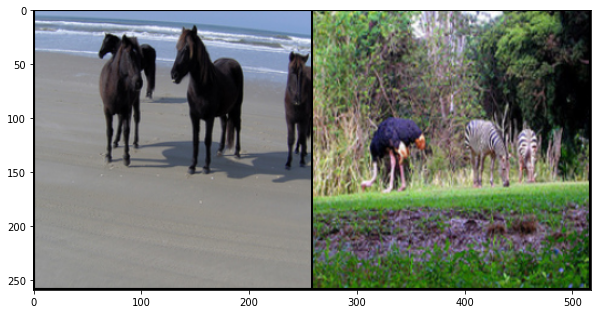

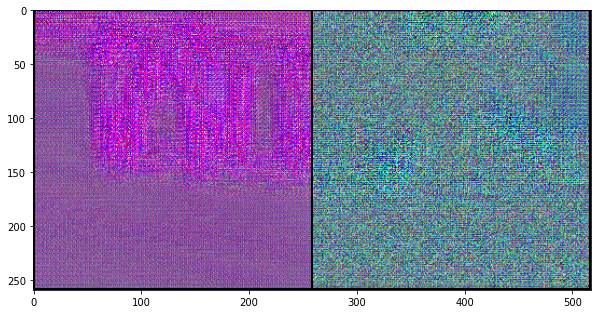

Epoch 0: Step 200: Generator (U-Net) loss: 7.199664556980135, Discriminator loss: 0.25025409393012515


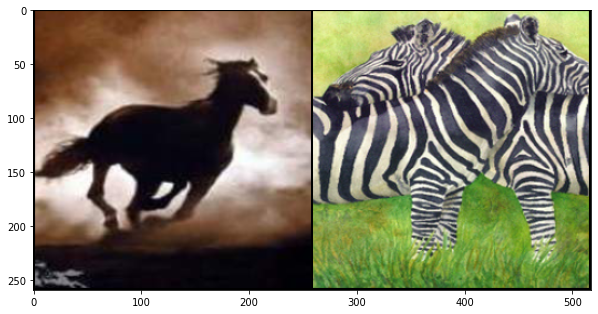

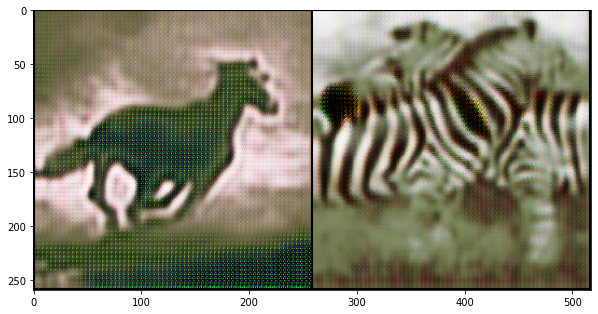

Epoch 0: Step 400: Generator (U-Net) loss: 6.547740266323089, Discriminator loss: 0.21092279143631457


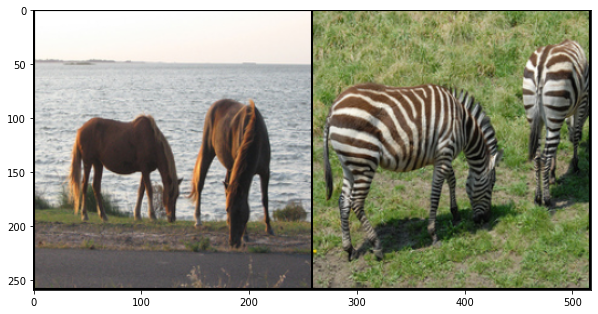

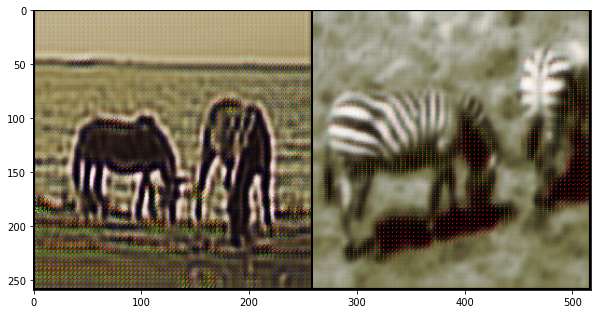

Epoch 0: Step 600: Generator (U-Net) loss: 6.26736487865448, Discriminator loss: 0.14723270641639827


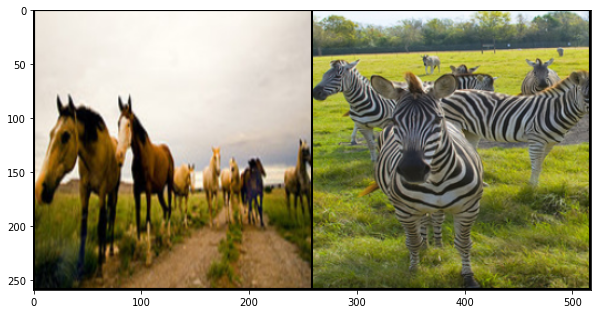

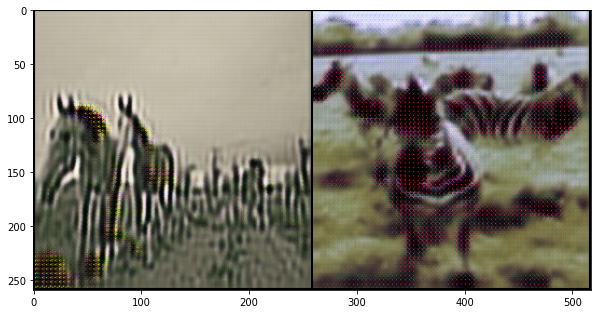

Epoch 0: Step 800: Generator (U-Net) loss: 6.157320923805234, Discriminator loss: 0.10121488319709902


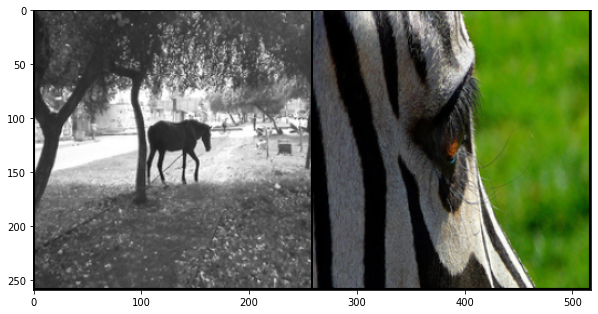

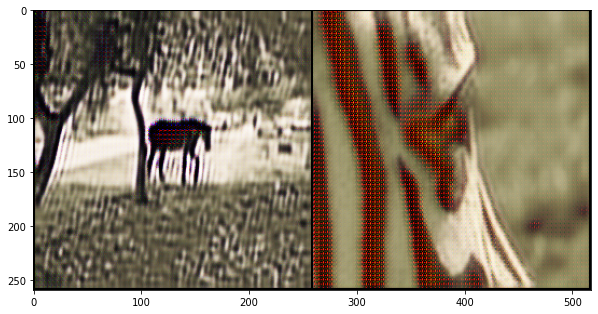

Epoch 0: Step 1000: Generator (U-Net) loss: 5.769928177595136, Discriminator loss: 0.17749209547415373


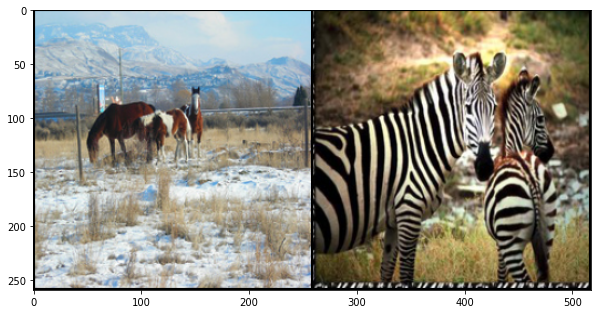

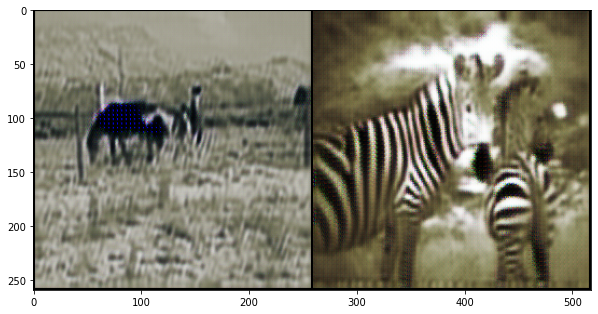

Epoch 1: Step 1200: Generator (U-Net) loss: 5.4441926407814, Discriminator loss: 0.24534752104431382


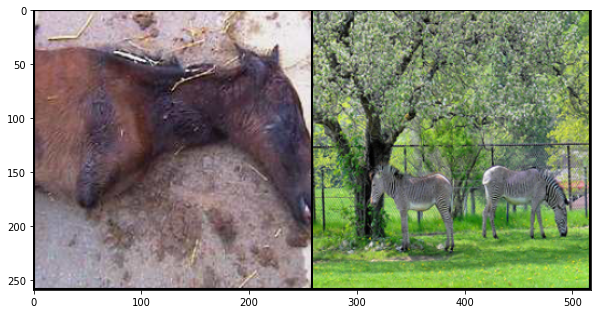

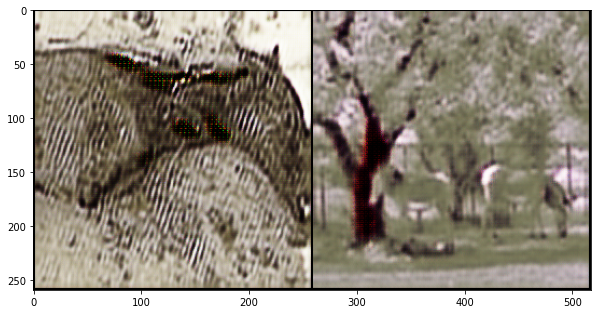

Epoch 1: Step 1400: Generator (U-Net) loss: 5.320466440916059, Discriminator loss: 0.2284943204373121


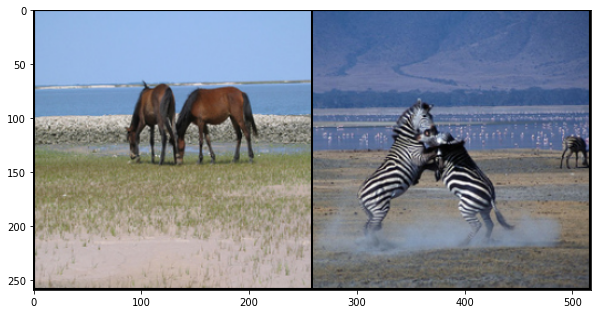

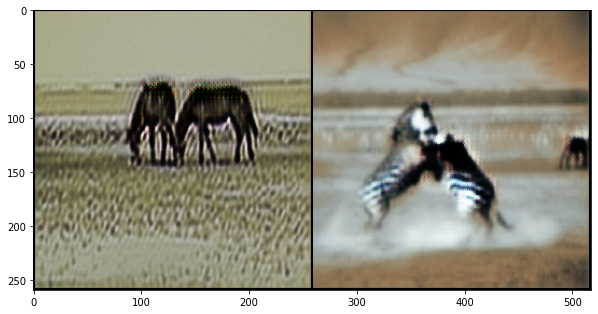

Epoch 1: Step 1600: Generator (U-Net) loss: 5.16555243372917, Discriminator loss: 0.22889266960322863


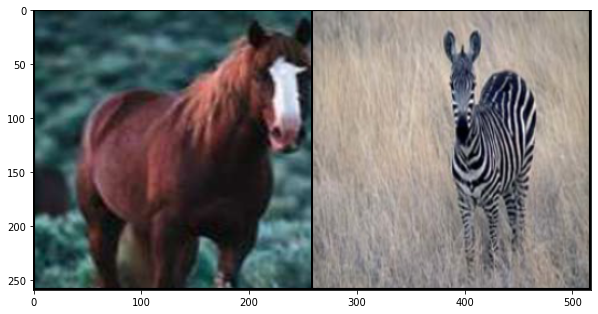

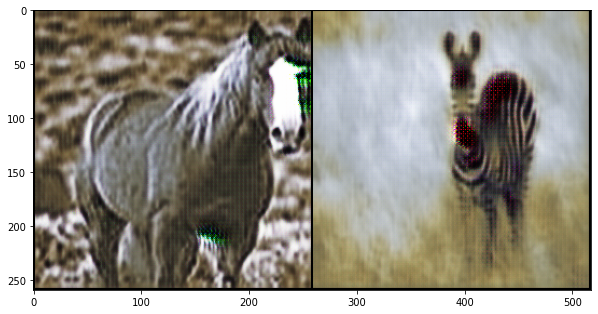

Epoch 1: Step 1800: Generator (U-Net) loss: 5.062926249504091, Discriminator loss: 0.23324768915772437


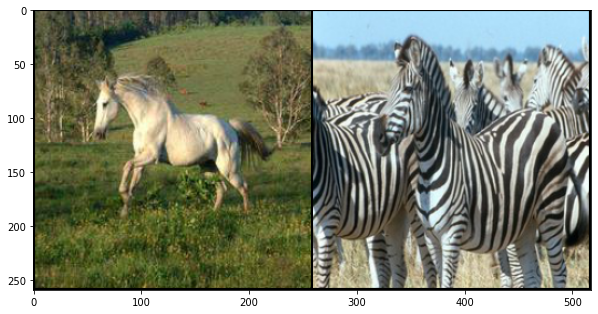

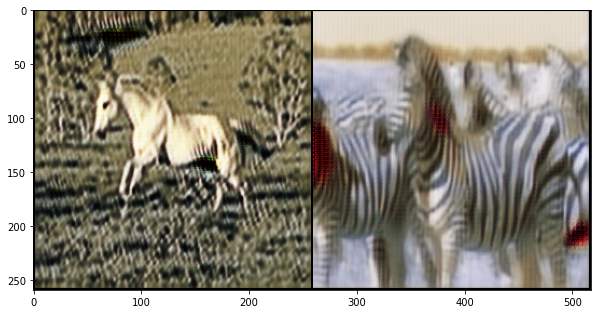

Epoch 1: Step 2000: Generator (U-Net) loss: 5.094541881084444, Discriminator loss: 0.22783781424164762


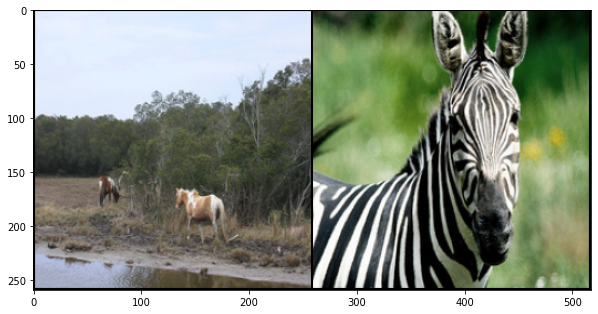

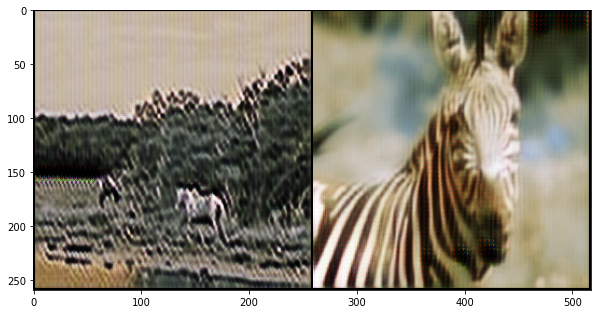

Epoch 2: Step 2200: Generator (U-Net) loss: 4.968577361106871, Discriminator loss: 0.23937178194522862


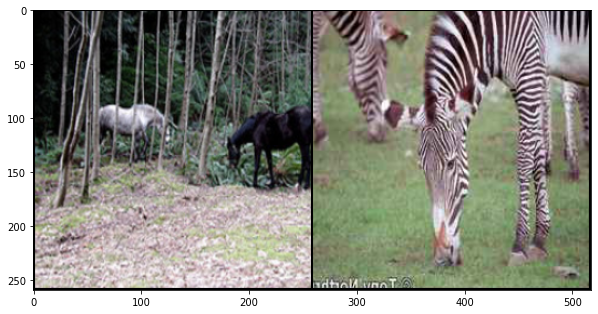

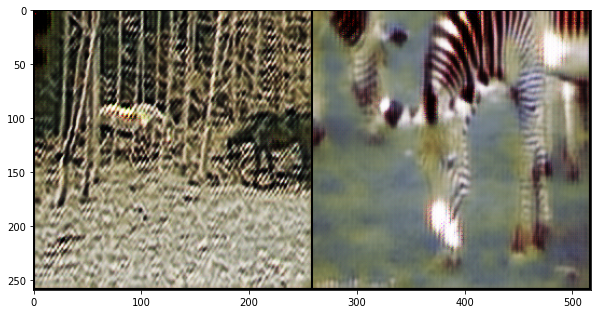

Epoch 2: Step 2400: Generator (U-Net) loss: 4.998393652439117, Discriminator loss: 0.2316835650615394


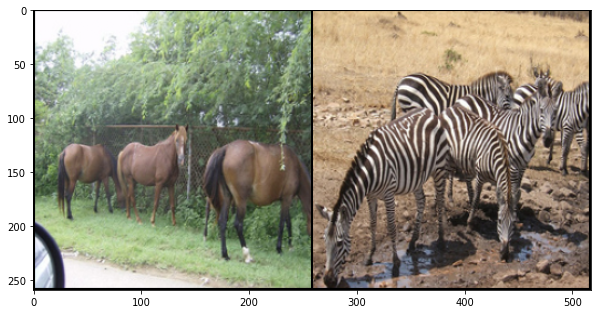

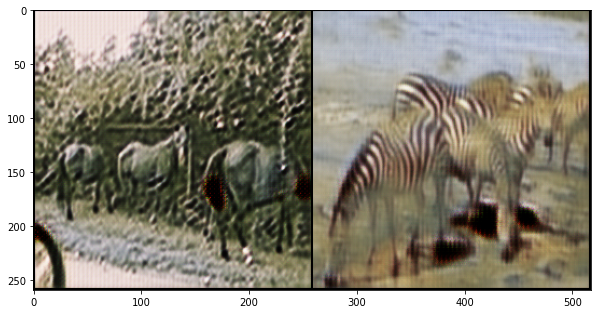

Epoch 2: Step 2600: Generator (U-Net) loss: 4.8071467578411085, Discriminator loss: 0.21882512927055367


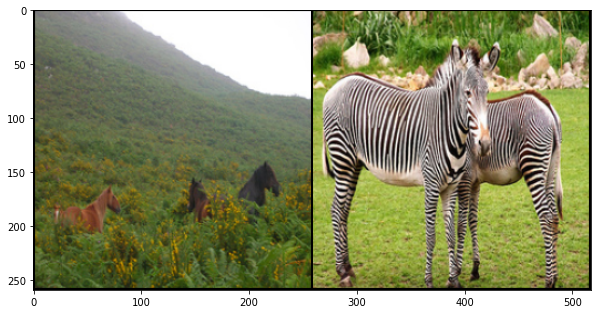

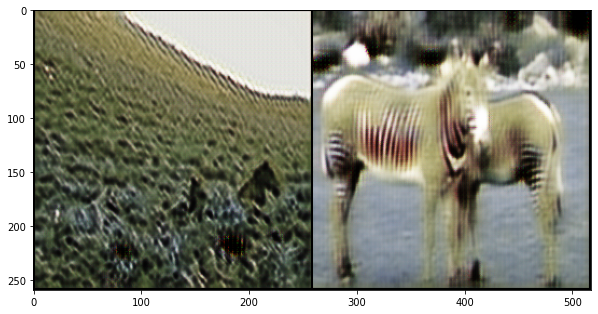

Epoch 2: Step 2800: Generator (U-Net) loss: 4.740646474361419, Discriminator loss: 0.2296166836097837


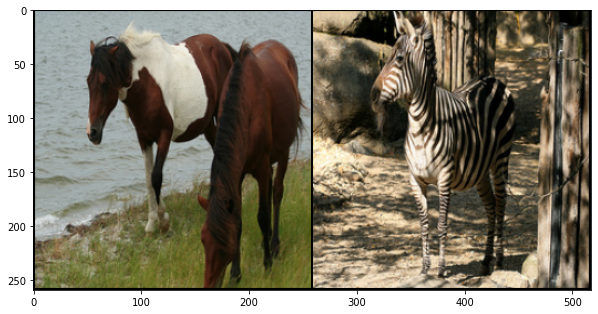

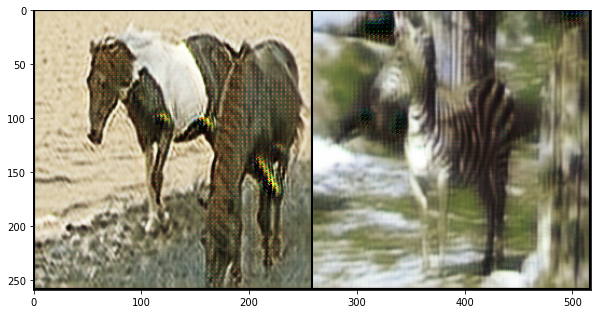

Epoch 2: Step 3000: Generator (U-Net) loss: 4.559572439193725, Discriminator loss: 0.2379605333507062


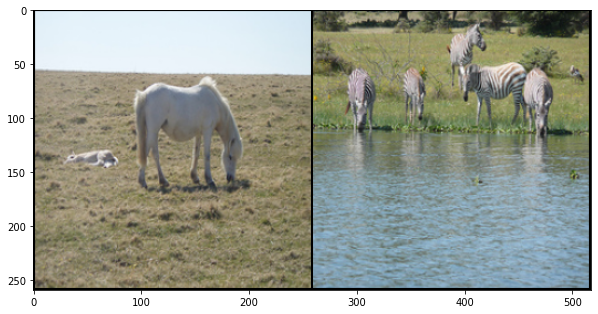

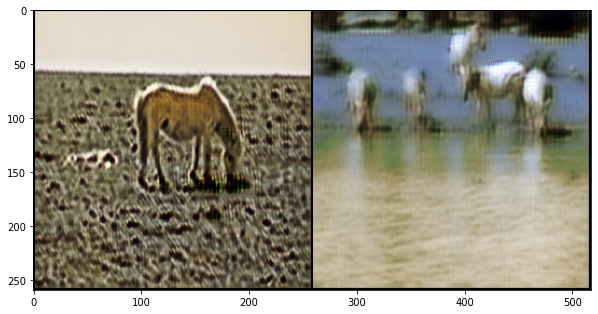

Epoch 2: Step 3200: Generator (U-Net) loss: 4.660754600763318, Discriminator loss: 0.23461785104125737


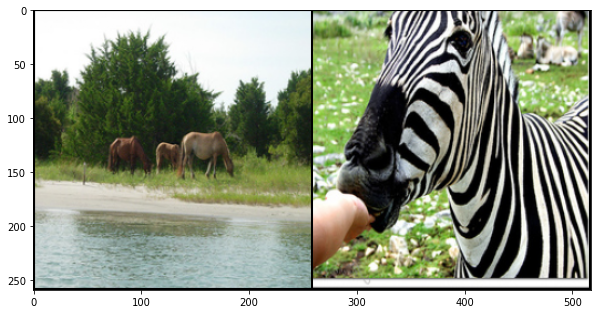

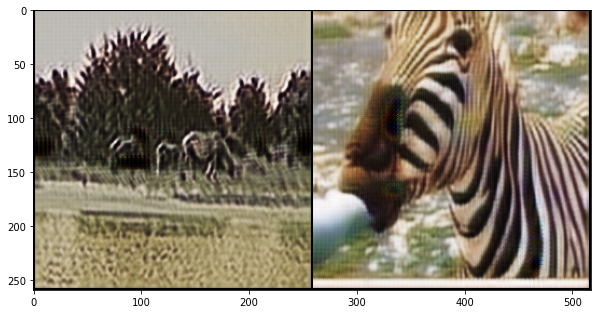

Epoch 3: Step 3400: Generator (U-Net) loss: 4.75145869135857, Discriminator loss: 0.22891760423779486


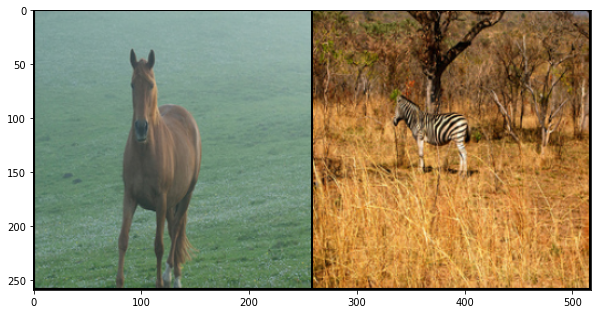

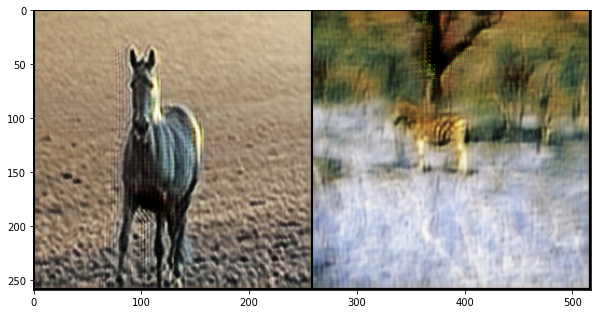

Epoch 3: Step 3600: Generator (U-Net) loss: 4.646807202100752, Discriminator loss: 0.23172443434596043


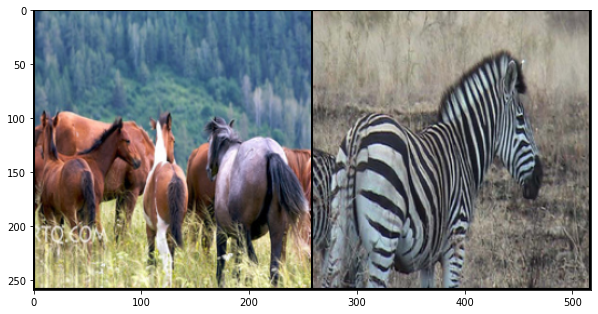

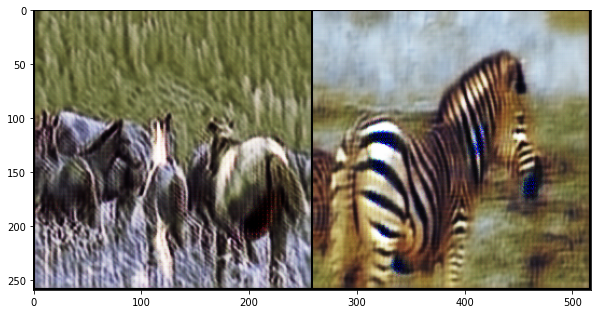

Epoch 3: Step 3800: Generator (U-Net) loss: 4.581831300258635, Discriminator loss: 0.2294562808796764


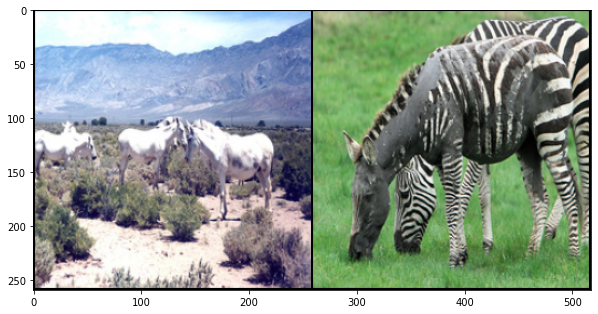

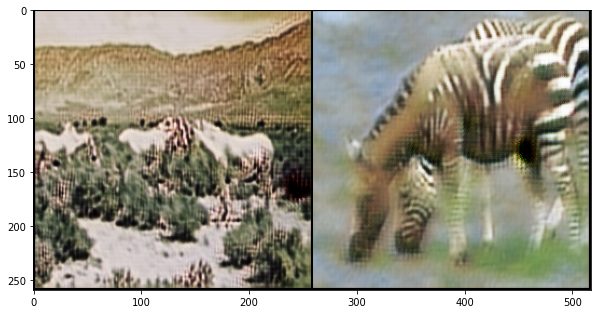

Epoch 3: Step 4000: Generator (U-Net) loss: 4.649553576707839, Discriminator loss: 0.22661516025662415


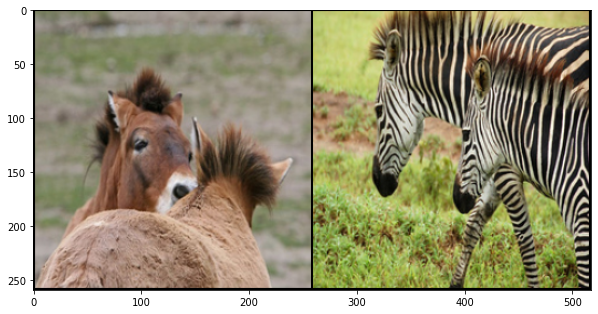

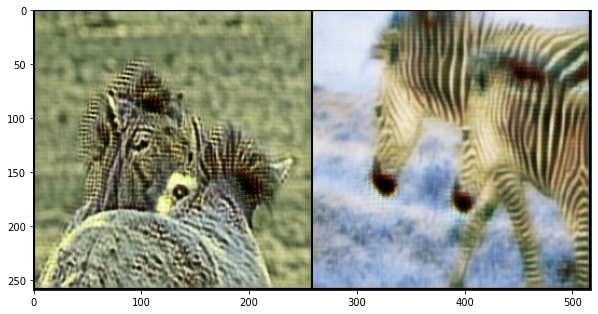

Epoch 3: Step 4200: Generator (U-Net) loss: 4.644834755659104, Discriminator loss: 0.2338712510839106


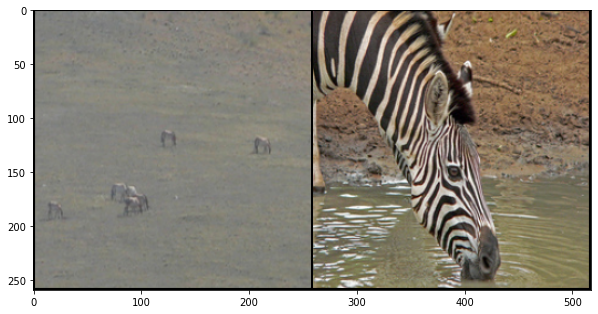

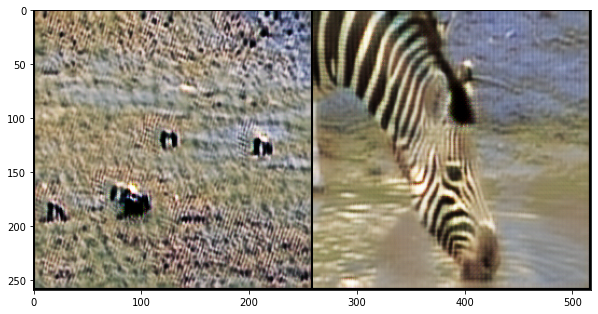

Epoch 4: Step 4400: Generator (U-Net) loss: 4.348578593730926, Discriminator loss: 0.24061574637889863


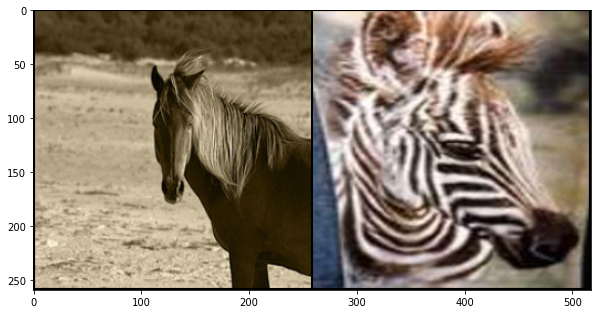

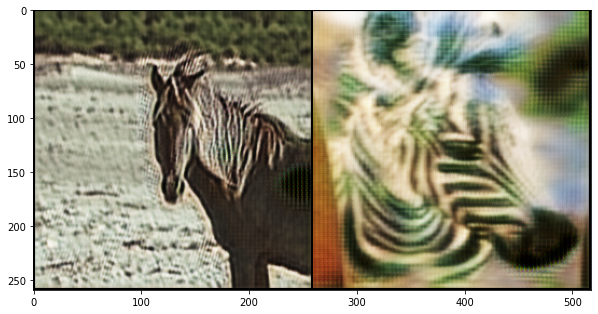

Epoch 4: Step 4600: Generator (U-Net) loss: 4.541794632673265, Discriminator loss: 0.22722116883844123


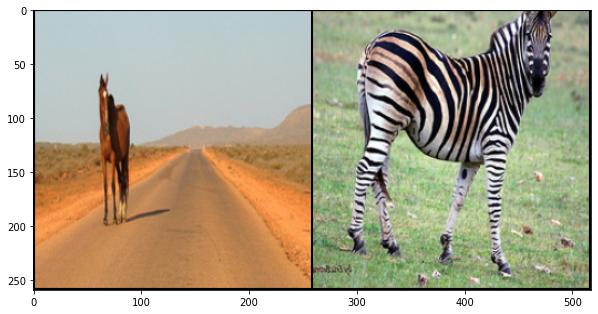

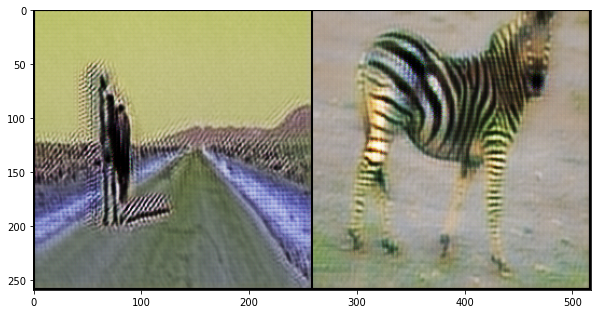

Epoch 4: Step 4800: Generator (U-Net) loss: 4.334329378604888, Discriminator loss: 0.24246048312634236


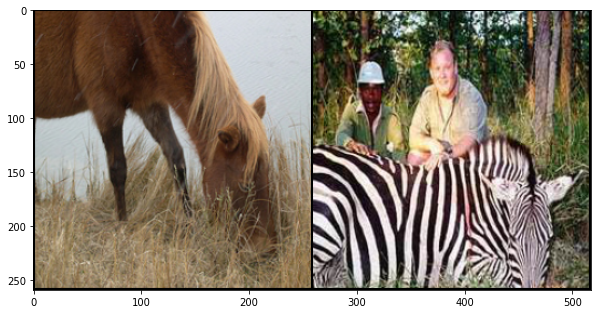

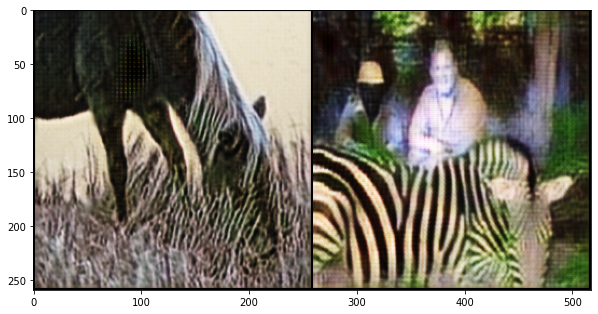

Epoch 4: Step 5000: Generator (U-Net) loss: 4.207583920955655, Discriminator loss: 0.23652566254138943


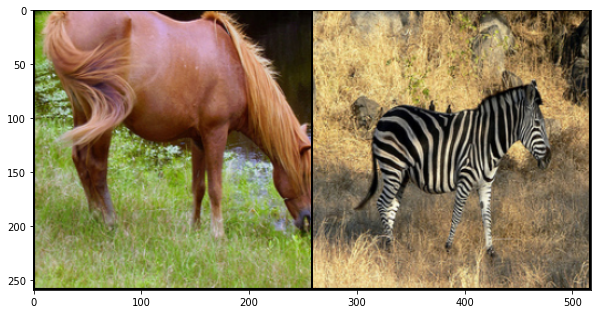

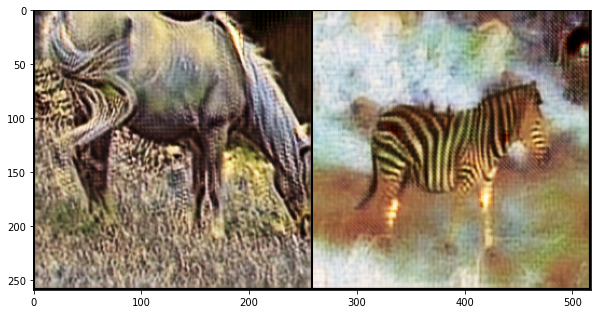

Epoch 4: Step 5200: Generator (U-Net) loss: 4.299266371726989, Discriminator loss: 0.23061572048813106


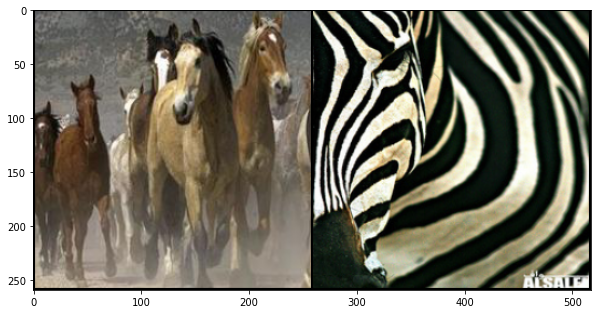

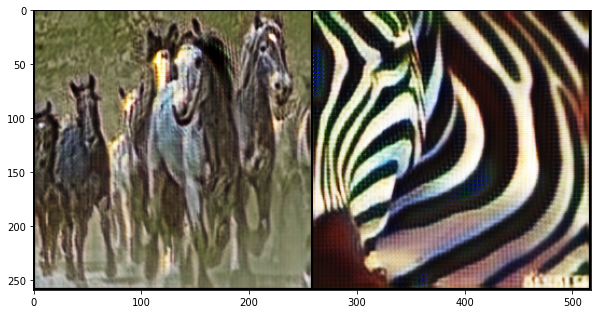

Epoch 5: Step 5400: Generator (U-Net) loss: 4.1805582737922675, Discriminator loss: 0.23792245969176298


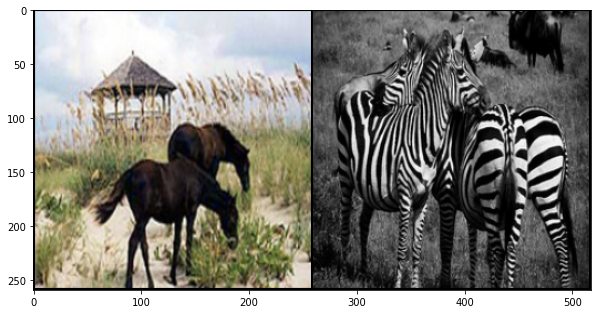

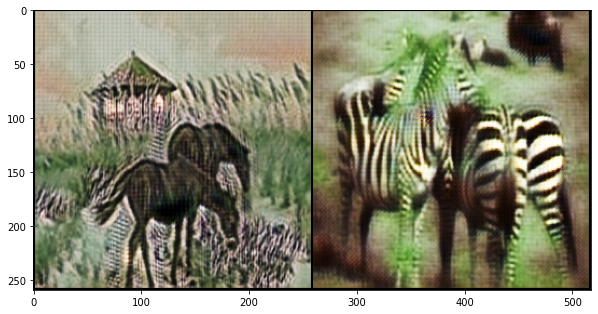

Epoch 5: Step 5600: Generator (U-Net) loss: 4.16967052221298, Discriminator loss: 0.23109109807759529


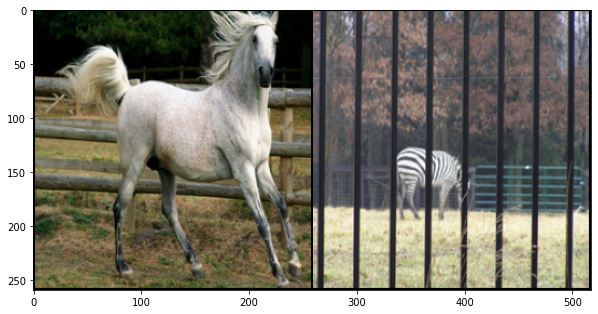

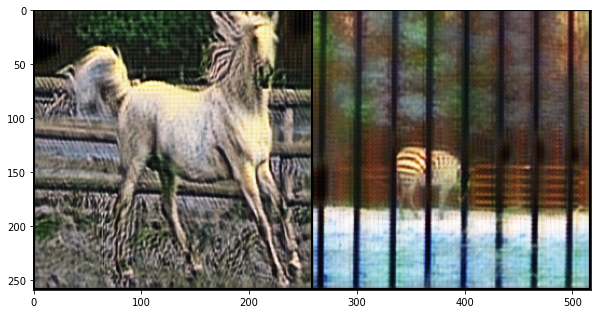

Epoch 5: Step 5800: Generator (U-Net) loss: 4.171710534095764, Discriminator loss: 0.22992978982627382


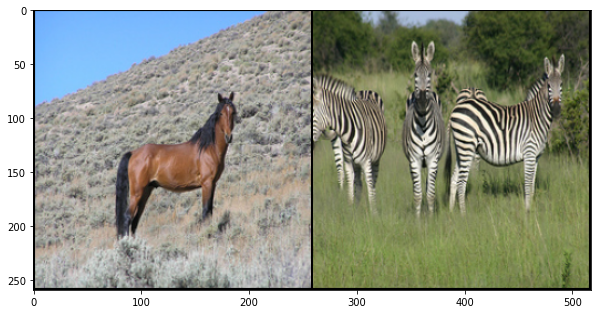

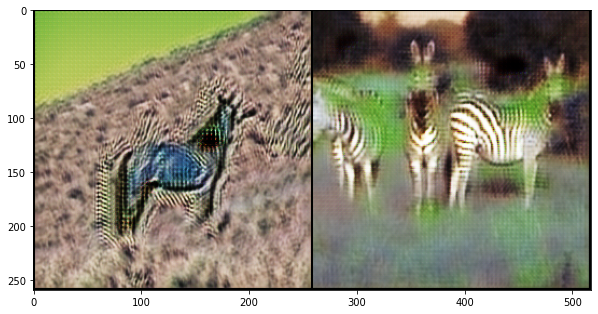

Epoch 5: Step 6000: Generator (U-Net) loss: 4.246826783418655, Discriminator loss: 0.23461853478103878


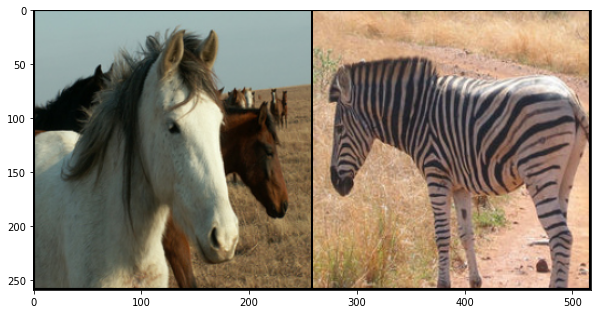

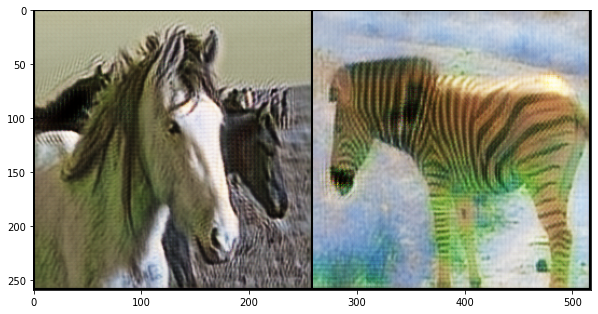

Epoch 5: Step 6200: Generator (U-Net) loss: 4.2378932034969345, Discriminator loss: 0.22412205848842867


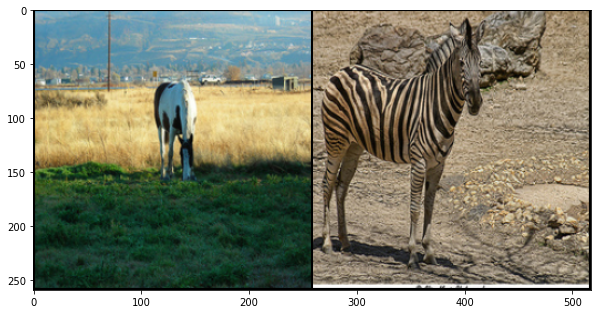

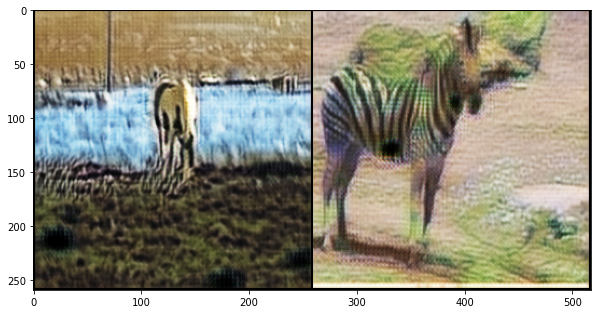

Epoch 5: Step 6400: Generator (U-Net) loss: 4.128954639434816, Discriminator loss: 0.22752128519117829


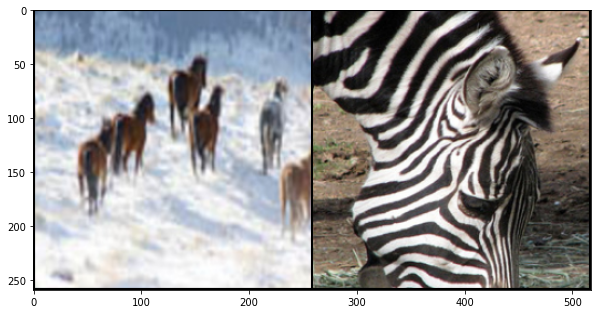

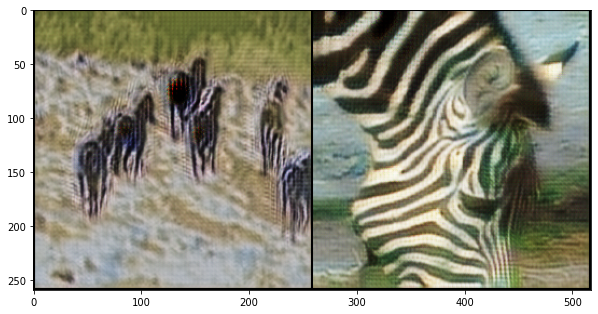

Epoch 6: Step 6600: Generator (U-Net) loss: 4.110581139326096, Discriminator loss: 0.22811338271945694


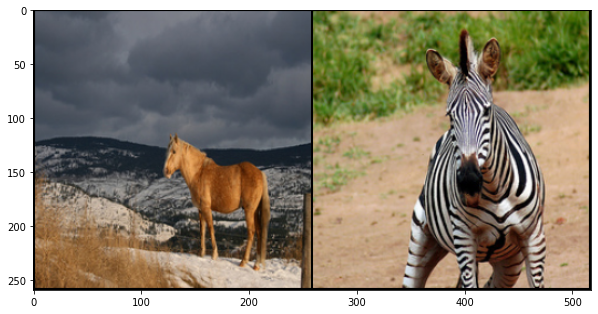

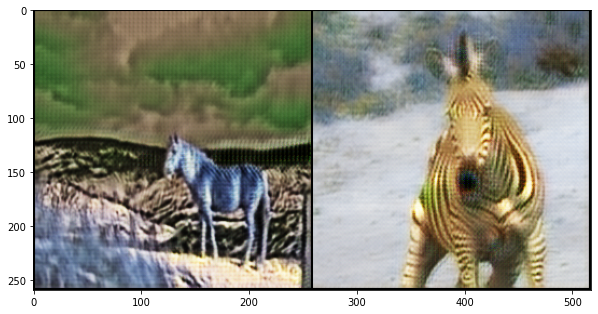

KeyboardInterrupt: ignored

In [23]:
train()